In [1]:
import numpy as np
from scipy.integrate import odeint
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("whitegrid")
import time
import pickle
from matplotlib import animation

# cells defined in earlier notebooks

In [2]:
"""
parameters from Zaytsev 2016
"""

kcis = 7.29*10**-6    # 1/s        # rate constant for 'in cis' Aurora B activation

kfa  = 0.1            # 1/(uM*s)   # rate constant for AA complex formation
kca  = 2.7*10**-2     # 1/s        # rate constant for AA catalysis
Kma  = 51             # uM         # Michaelis constant for AA 'in trans' activation
kra  = kfa*Kma-kca    # 1/         # rate constant for AA complex dissociation

kfp  = 0.6            # 1/(uM*s)   # rate constant for PhA complex formation
kcp  = 2.4*10**-2     # 1/s        # rate constant for PhA catalysis
Kmp  = 1.95           # uM         # Michaelis constant for PhA 'in trans' activation
krp  = kfp*Kmp-kcp    # 1/s        # rate constant for PhA complex dissociation

In [3]:
def mesh_fourier(zmin,zmax,nz):
    """
    discrete approximation of the spatial derivative operator (Laplacian)
    uses spectral symmetry to simplify operations, forces periodic boundary conditions
    """
    dz = np.zeros((nz,nz))
    for i in range(nz):
        for j in range(nz):
            if i == j:
                dz[i,i] = 0
            else:
                dz[i,j] = np.pi*(-1)**((i-1)+(j-1))/(zmax-zmin)/np.tan(((i-1)-(j-1))*np.pi/(nz))
    return dz

In [4]:
def find_nearest(array, value):
    """
    returns location of point nearest to input value within input array
    """
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return array[idx], idx

In [5]:
def R_binding(y):
    """
    system of ODEs from Zaytsev 2016 where kinase binding to sites along a chromosome is included,
    previously defined a/A/aA/PhA components involve a diffusible/unbound Aurora B kinase,
    the following components are introduced in this model:
    - b: inactive/bound Aurora B kinase
    - B: active/bound Aurora B kinase
    - aB/bA/bB: enzyme-substrate complexes of inactive/active/bound/diffusible Aurora B kinase
    - PhB: enzyme-substrate complex of phosphatase + active/bound Aurora B kinase
    - BS: free binding sites
    """
    A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS = y

    dAdt = (kcis - kfa*A)*a + (kra + 2*kca)*aA - kfp*A*Ph + krp*PhA +\
        kca*aB - kfa*A*b + (kra + kca)*bA + koff*B - kon*BS*A
    
    dBdt = (kcis - kfb*B)*b + (krb + 2*kca)*bB - kfp*B*Ph + krp*PhB +\
        kca*bA - kfa*B*a + (kra + kca)*aB - koff*B + kon*BS*A
    
    dadt = -(kcis + kfa*A + kfa*B)*a + kra*(aA + aB) + kcp*PhA + koff*b - kon*BS*a
    dbdt = -(kcis + kfb*B + kfa*A)*b + krb*bB + kra*bA + kcp*PhB - koff*b + kon*BS*a
    
    daAdt = kfa*a*A - (kra + kca)*aA
    daBdt = kfa*a*B - (kra + kca)*aB
    dbAdt = kfa*b*A - (kra + kca)*bA
    dbBdt = kfb*b*B - (krb + kca)*bB
    
    dPhdt = -kfp*Ph*(A + B) + (krp + kcp)*(PhA + PhB)
    dPhAdt = kfp*Ph*A - (krp + kcp)*PhA
    dPhBdt = kfp*Ph*B - (krp + kcp)*PhB
    
    return dAdt, dBdt, dadt, dbdt, daAdt, daBdt, dbAdt, dbBdt, dPhdt, dPhAdt, dPhBdt

In [6]:
def spatial_simulation_binding(A0,Atot,P0,t_end,dt,t_save,L,N,BSmin,BSw):
    """
    reaction-diffusion algorithm with added binding/localization reactions
    available chromosomal binding sites are situated in a Gaussian-like distribution
    initial kinase/phosphatase conditions are constant across domain
    """
    A = np.zeros(N) + A0
    B = np.zeros(N)
    a = np.zeros(N) + Atot - A
    b = np.zeros(N)
    aA = np.zeros(N)
    aB = np.zeros(N)
    bA = np.zeros(N)
    bB = np.zeros(N)
    Ph = np.zeros(N) + P0
    PhA = np.zeros(N)
    PhB = np.zeros(N)
    
    x = np.linspace(-L/2, L/2, N)
    
    BS0 = (Atot - BSmin) * np.exp(- Atot / BSw * x**2) + BSmin
    
    y = A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS0
    
    A_arr = np.zeros((N,round(t_end/t_save)+1))
    B_arr = np.zeros((N,round(t_end/t_save)+1))
    a_arr = np.zeros((N,round(t_end/t_save)+1))
    b_arr = np.zeros((N,round(t_end/t_save)+1))
    aA_arr = np.zeros((N,round(t_end/t_save)+1))
    aB_arr = np.zeros((N,round(t_end/t_save)+1))
    bA_arr = np.zeros((N,round(t_end/t_save)+1))
    bB_arr = np.zeros((N,round(t_end/t_save)+1))
    Ph_arr = np.zeros((N,round(t_end/t_save)+1))
    PhA_arr = np.zeros((N,round(t_end/t_save)+1))
    PhB_arr = np.zeros((N,round(t_end/t_save)+1))
    BS_arr = np.zeros((N,round(t_end/t_save)+1))
    t_vec = np.zeros(round(t_end/t_save)+1)
    
    A_arr[:,0] = A
    a_arr[:,0] = a
    Ph_arr[:,0] = Ph
    BS_arr[:,0] = BS0
    
    dz = mesh_fourier(0,L,N)
    dz2 = np.dot(dz,dz)
    
    counter = -1
    counter_save = 0
    t = 0
    
    for i in range(round(t_end/dt)+1):
        counter += 1
        
        dy = R_binding(y)
        
        A += dt*(dy[0] + D*np.dot(dz2,A))
        B += dt*dy[1]
        a += dt*(dy[2] + D*np.dot(dz2,a))
        b += dt*dy[3]
        aA += dt*(dy[4] + D*np.dot(dz2,aA))
        aB += dt*dy[5]
        bA += dt*dy[6]
        bB += dt*dy[7]
        Ph += dt*(dy[8] + D*np.dot(dz2,Ph))
        PhA += dt*(dy[9] + D*np.dot(dz2,PhA))
        PhB += dt*dy[10]
        
        BS = BS0 - B - b - aB - bA - 2*bB - PhB
        
        y = A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS
        
        t += dt
        
        if counter == round(t_save/dt):
            counter = 0
            counter_save += 1
            
            A_arr[:,counter_save] = A
            B_arr[:,counter_save] = B
            a_arr[:,counter_save] = a
            b_arr[:,counter_save] = b
            aA_arr[:,counter_save] = aA
            aB_arr[:,counter_save] = aB
            bA_arr[:,counter_save] = bA
            bB_arr[:,counter_save] = bB
            Ph_arr[:,counter_save] = Ph
            PhA_arr[:,counter_save] = PhA
            PhB_arr[:,counter_save] = PhB
            BS_arr[:,counter_save] = BS
            t_vec[counter_save] = t
    
    arrays = A_arr, B_arr, a_arr, b_arr, aA_arr, aB_arr, bA_arr, bB_arr, Ph_arr, PhA_arr, PhB_arr, BS_arr, t_vec
    y = A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS
    
    return arrays, y

In [7]:
"""
additional parameters for the binding model 
previously defined parameters for the nonbinding model still apply
"""

# sterically limited b*B in trans autoactivation
kfb   = kfa * 0.01      # 1/(uM*s)
Kmb   = Kma * 100       # uM
kra   = kfa*Kma-kca     # 1/s
krb   = kfb*Kma-kca     # 1/s

# rate constants for kinase binding + dissociating from binding sites
kon = 2.9                # 1/(uM*s)
koff = 0.014             # 1/s

In [8]:
"""
sums matrix slices to compose time or space profiles of active kinase, total kinase, and phosphatase
where time profiles are spatially specific and extend through time
and space profiles are temporally specific and extend throughout the spatial domain
while the other functions return spatially/temporally specific points
"""

def ABKp_space_profile(t):
    return A_arr[:,t]+B_arr[:,t]
def ABKp_time_profile(x):
    return A_arr[x,:]+B_arr[x,:]
def ABKp_pt(x,t):
    return A_arr[x,t]+B_arr[x,t]

def totalABK_space_profile(t):
    kinase = A_arr[:,t]+B_arr[:,t]+\
        a_arr[:,t]+b_arr[:,t]+\
        2*aA_arr[:,t]+2*aB_arr[:,t]+\
        2*bA_arr[:,t]+2*bB_arr[:,t]+\
        PhA_arr[:,t]+PhB_arr[:,t]
    return kinase
def totalABK_time_profile(x):
    kinase = A_arr[x,:]+B_arr[x,:]+\
        a_arr[x,:]+b_arr[x,:]+\
        2*aA_arr[x,:]+2*aB_arr[x,:]+\
        2*bA_arr[x,:]+2*bB_arr[x,:]+\
        PhA_arr[x,:]+PhB_arr[x,:]
    return kinase
def totalABK_pt(x,t):
    kinase = A_arr[x,t]+B_arr[x,t]+a_arr[x,t]+b_arr[x,t]+\
        2*aA_arr[x,t]+2*aB_arr[x,t]+2*bA_arr[x,t]+2*bB_arr[x,t]+\
        PhA_arr[x,t]+PhB_arr[x,t]
    return kinase

def PPase_space_profile(t):
    return Ph_arr[:,t]+PhA_arr[:,t]+PhB_arr[:,t]
def PPase_time_profile(x):
    return Ph_arr[x,:]+PhA_arr[x,:]+PhB_arr[x,:]
def PPase_pt(x,t):
    return Ph_arr[x,t]+PhA_arr[x,t]+PhB_arr[x,t]

In [9]:
"""
algorithm to pull the times/active kinase values of each discretized x_slice (blue/orange/green pts)
at four intervals proportional to the respective low/high steady states
similar as for the phenomenological model discretization in Figure 17C (notebook 6.5)
"""

def discretize_into_slices(x_slices):
    t_of_xslices = []
    ABKp_of_xslices = []
    totalABK_of_xslices = []
    PPase_of_xslices = []

    for x_slice in x_slices:

        # lo/hi = initial/final values (diffusible + bound kinase) for each x_slice
        lo = ABKp_pt(x_slice,0)
        hi = ABKp_pt(x_slice,-1)

        # start each list with initial values
        t_of_xslice = [0]
        ABKp_of_xslice = [lo]
        totalABK_of_xslice = [totalABK_pt(x_slice,0)]
        PPase_of_xslice = [PPase_pt(x_slice,0)]

        # 3 intermediate + 1 approximate final level
        intervals = [.2, .5, .8, .99]
        for interval in intervals:

            # calculate interval position, find nearest point, extract active kinase + time
            ABKp, t = find_nearest( ABKp_time_profile(x_slice), interval*(hi-lo)+lo )
            ABKp_of_xslice.append(ABKp)
            t_of_xslice.append(t/60)

            # use this time to extract total kinase + phosphatase
            totalABK_of_xslice.append( totalABK_pt(x_slice,t) )
            PPase_of_xslice.append( PPase_pt(x_slice,t) )

        t_of_xslices.append(t_of_xslice)
        ABKp_of_xslices.append(ABKp_of_xslice)
        totalABK_of_xslices.append(totalABK_of_xslice)
        PPase_of_xslices.append(PPase_of_xslice)
        
    return t_of_xslices, ABKp_of_xslices, totalABK_of_xslices, PPase_of_xslices

# diffusing vs. stationary phosphatase

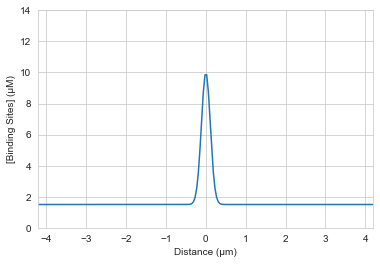

In [10]:
"""
constructs/plots kinase chromosomal binding site profile to be used for simulations below
"""
N = 480
L = 20
x_span = np.linspace(-L/2,L/2,N)

# narrows initial binding site profile relative to Figure 21A (smaller BSw)
Atot = 10
BSmin = 1.5
BSw = 0.25

BS0 = (Atot-BSmin) * np.exp(- Atot / BSw * x_span**2) + BSmin

plt.plot(x_span,BS0)
plt.ylim(0,14)
plt.xlim(-4.2,4.2)
plt.ylabel('[Binding Sites] (\u03BCM)')
plt.xlabel('Distance (\u03BCm)');

In [11]:
"""
parameters for simulation below
"""
t_end = 4000*60
dt = 0.035
t_save = 60

A0 = 0
P0 = 0.55

D = 10**-5

In [90]:
"""
simulates reaction/diffusion/localization with 0.55 uM phosphatase + 10e-5 diffusion coefficient
total kinase kept at 10 uM across domain length, initial active kinase at zero
binding site profile used is plotted above
"""

start = time.time()
## algorithm takes >1 hr

bindingsim_P055_dynamic_narrow, y = spatial_simulation_binding(A0,Atot,P0,t_end,dt,t_save,L,N,BSmin,BSw)

pickle.dump(bindingsim_P055_dynamic_narrow,open('bindingsim_P055_dynamic_narrow','wb'))

end = time.time()
print(f'~ {round( (end - start)/60, 1 )} min')

~ 79.2 min


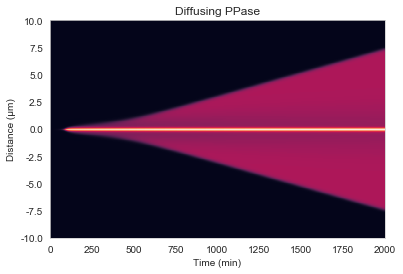

In [12]:
"""
Figure 22A
plots simulation results as a spatiotemporal heatmap
- no new conclusions, will be used to compare with fixed PPase results below
"""

bindingsim_P055_dynamic_narrow = pickle.load(open('bindingsim_P055_dynamic_narrow','rb'))

[   A_arr, B_arr, a_arr, b_arr, aA_arr, aB_arr, bA_arr, bB_arr, 
    Ph_arr, PhA_arr, PhB_arr, BS_arr, t_vec 
] = bindingsim_P055_dynamic_narrow

plt.pcolor(A_arr[:,:2000]+B_arr[:,:2000])
plt.yticks(np.linspace(0,480,9), np.arange(-10, 11, 2.5))
plt.title('Diffusing PPase')
plt.ylabel('Distance (\u03BCm)')
plt.xlabel('Time (min)');

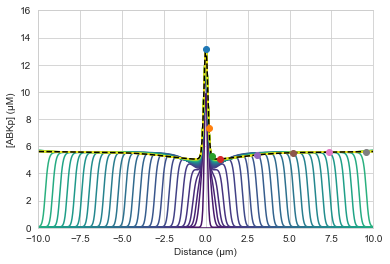

In [13]:
"""
Supplemental Figure 18A 
plots simulation results with a 100 min separation between each spatial profile
plus points indicating 8 different x_slices
- no new conclusions, will be used to compare with fixed PPase results below
"""

end = int(t_end/60)
lin_range = range(0,end,100)

# plots active kinase profiles
colors = sns.color_palette('viridis', n_colors=len(lin_range))
for n,i in enumerate(lin_range):
    plt.plot(x_span, ABKp_space_profile(i), color=colors[n])
plt.plot(x_span, ABKp_space_profile(end), 'k--')
plt.xlabel("Distance (\u03BCm)")
plt.ylabel("[ABKp] (\u03BCM)")
plt.ylim(0,16)
plt.xlim(-10,10)

# plots eight points along ending active kinase profile
x_slices = [60*4, 61*4, 62*4, 65*4, 78*4, 91*4, 104*4, 117*4]
colors = ['C0o','C1o','C2o','C3o','C4o','C5o','C6o','C7o']
for x,color in zip(x_slices,colors):
    plt.plot(x_span[x], ABKp_pt(x,end), color)
plt.show()

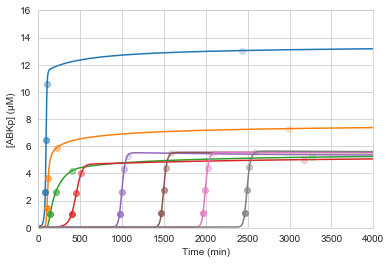

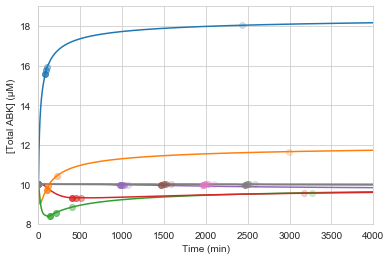

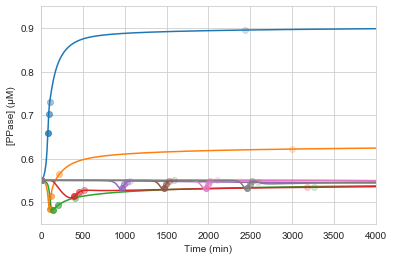

In [14]:
"""
Supplemental Figure 18C
plots active kinase / total kinase / PPase curves (diffusible + bound) with time of the 8 x_slices
plus points indicating 4 intervals in respect to low/high steady states
- no new conclusions, will be used to compare with fixed PPase results below
"""

t_of_xslices, ABKp_of_xslices, totalABK_of_xslices, PPase_of_xslices = discretize_into_slices(x_slices)

t = np.arange(0, t_end+.1, t_save)
# active kinase trajectories + interval points
alphas = [1,.8,.6,.4,.2]
for x_slice in x_slices:
    plt.plot(t/60, ABKp_time_profile(x_slice))
for x_slice,ts,ABKps,color in zip(x_slices, t_of_xslices, ABKp_of_xslices, colors):
    for t_,ABKp_,alp in zip(ts, ABKps, alphas):
        plt.plot(t_*t_save, ABKp_, color, alpha=alp)

plt.xlim(0,t_end/60)
plt.ylim(0,16)
plt.ylabel('[ABKp] (\u03BCM)')
plt.xlabel('Time (min)')
plt.show()

# total kinase trajectories + interval points
for x_slice in x_slices:
    plt.plot(t/60, totalABK_time_profile(x_slice))
for x_slice,ts,totalABKs,color in zip(x_slices, t_of_xslices, totalABK_of_xslices, colors):
    for t_,totalABK_,alp in zip(ts, totalABKs, alphas):
        plt.plot(t_*t_save, totalABK_, color, alpha=alp)

plt.xlim(0,t_end/60)
plt.ylim(8,19)
plt.ylabel('[Total ABK] (\u03BCM)')
plt.xlabel('Time (min)')
plt.show()

# PPase trajectories + interval points
for c,x_slice in enumerate(x_slices):
    plt.plot(t/60, PPase_time_profile(x_slice))
for x_slice,ts,PPases,color in zip(x_slices, t_of_xslices, PPase_of_xslices, colors):
    for t_,PPase_,alp in zip(ts, PPases, alphas):
        plt.plot(t_*t_save, PPase_, color, alpha=alp)

plt.xlim(0,t_end/60)
plt.ylim(.45,.95)
plt.ylabel('[PPase] (\u03BCM)')
plt.xlabel('Time (min)');

In [15]:
def spatial_simulation_binding_noPPdiff(A0,Atot,P0,t_end,dt,t_save,L,N,BSmin,BSw):
    """
    identical algorithm as spatial_simulation_binding with Ph & PhA diffusion terms removed
    """
    A = np.zeros(N) + A0
    B = np.zeros(N)
    a = np.zeros(N) + Atot - A
    b = np.zeros(N)
    aA = np.zeros(N)
    aB = np.zeros(N)
    bA = np.zeros(N)
    bB = np.zeros(N)
    Ph = np.zeros(N) + P0
    PhA = np.zeros(N)
    PhB = np.zeros(N)
    
    x = np.linspace(-L/2, L/2, N)
    
    BS0 = (Atot - BSmin) * np.exp(- Atot / BSw * x**2) + BSmin
    
    y = A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS0
    
    A_arr = np.zeros((N,round(t_end/t_save)+1))
    B_arr = np.zeros((N,round(t_end/t_save)+1))
    a_arr = np.zeros((N,round(t_end/t_save)+1))
    b_arr = np.zeros((N,round(t_end/t_save)+1))
    aA_arr = np.zeros((N,round(t_end/t_save)+1))
    aB_arr = np.zeros((N,round(t_end/t_save)+1))
    bA_arr = np.zeros((N,round(t_end/t_save)+1))
    bB_arr = np.zeros((N,round(t_end/t_save)+1))
    Ph_arr = np.zeros((N,round(t_end/t_save)+1))
    PhA_arr = np.zeros((N,round(t_end/t_save)+1))
    PhB_arr = np.zeros((N,round(t_end/t_save)+1))
    BS_arr = np.zeros((N,round(t_end/t_save)+1))
    t_vec = np.zeros(round(t_end/t_save)+1)
    
    A_arr[:,0] = A
    a_arr[:,0] = a
    Ph_arr[:,0] = Ph
    BS_arr[:,0] = BS0
    
    dz = mesh_fourier(0,L,N)
    dz2 = np.dot(dz,dz)
    
    counter = -1
    counter_save = 0
    t = 0
    
    for i in range(round(t_end/dt)+1):
        counter += 1
        
        dy = R_binding(y)
        
        A += dt*(dy[0] + D*np.dot(dz2,A))
        B += dt*dy[1]
        a += dt*(dy[2] + D*np.dot(dz2,a))
        b += dt*dy[3]
        aA += dt*(dy[4] + D*np.dot(dz2,aA))
        aB += dt*dy[5]
        bA += dt*dy[6]
        bB += dt*dy[7]
        Ph += dt*dy[8]   # diffusion term removed
        PhA += dt*dy[9]  # diffusion term removed
        PhB += dt*dy[10]
        
        BS = BS0 - B - b - aB - bA - 2*bB - PhB
        
        y = A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS
        
        t += dt
        
        if counter == round(t_save/dt):
            counter = 0
            counter_save += 1
            
            A_arr[:,counter_save] = A
            B_arr[:,counter_save] = B
            a_arr[:,counter_save] = a
            b_arr[:,counter_save] = b
            aA_arr[:,counter_save] = aA
            aB_arr[:,counter_save] = aB
            bA_arr[:,counter_save] = bA
            bB_arr[:,counter_save] = bB
            Ph_arr[:,counter_save] = Ph
            PhA_arr[:,counter_save] = PhA
            PhB_arr[:,counter_save] = PhB
            BS_arr[:,counter_save] = BS
            t_vec[counter_save] = t
    
    arrays = A_arr, B_arr, a_arr, b_arr, aA_arr, aB_arr, bA_arr, bB_arr, Ph_arr, PhA_arr, PhB_arr, BS_arr, t_vec
    y = A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS
    
    return arrays, y

In [91]:
"""
same simulation parameters as above using the fixed phosphatase algorithm
"""

start = time.time()
## algorithm takes ~1 hr

bindingsim_P055_dynamic_narrow_fixedPPase, y = spatial_simulation_binding_noPPdiff(A0,Atot,P0,t_end,dt,t_save,L,N,BSmin,BSw)

pickle.dump(bindingsim_P055_dynamic_narrow_fixedPPase,open('bindingsim_P055_dynamic_narrow_fixedPPase','wb'))

end = time.time()
print(f'~ {round( (end - start)/60, 1 )} min')

~ 59.2 min


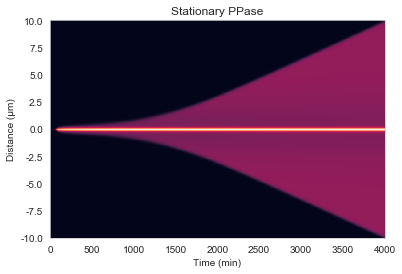

In [16]:
"""
Figure 22B
plots simulation results as a spatiotemporal heatmap

- increase in transition stall length
- decrease in front propagation speed along arms

    - fixed phosphatase prevents movement towards active kinase (inwards), 
    thus preventing the bistability curve from shifting left + lowering the threshold 
"""

bindingsim_P055_dynamic_narrow_fixedPPase = pickle.load(open('bindingsim_P055_dynamic_narrow_fixedPPase','rb'))

[   A_arr, B_arr, a_arr, b_arr, aA_arr, aB_arr, bA_arr, bB_arr, 
    Ph_arr, PhA_arr, PhB_arr, BS_arr, t_vec 
] = bindingsim_P055_dynamic_narrow_fixedPPase

plt.pcolor(A_arr[:2000]+B_arr[:2000])
plt.yticks(np.linspace(0,480,9), np.arange(-10, 11, 2.5))
plt.title('Stationary PPase')
plt.ylabel('Distance (\u03BCm)')
plt.xlabel('Time (min)');

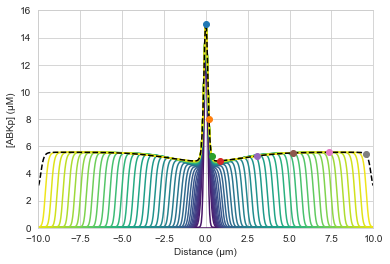

In [17]:
"""
Supplemental Figure 18B
plots simulation results with a 100 min separation between each spatial profile
plus point indicating 8 different x_slices

- spatial profiles are closer together - front travel speed is slower
"""

end = int(t_end/60)
lin_range = range(0,end,100)

# plots active kinase profiles
colors = sns.color_palette('viridis', n_colors=len(lin_range))
for n,i in enumerate(lin_range):
    plt.plot(x_span, ABKp_space_profile(i), color=colors[n])
plt.plot(x_span, ABKp_space_profile(end), 'k--')
plt.xlabel("Distance (\u03BCm)")
plt.ylabel("[ABKp] (\u03BCM)")
plt.ylim(0,16)
plt.xlim(-10,10)

# plots eight points along ending active kinase profile
x_slices = [60*4, 61*4, 62*4, 65*4, 78*4, 91*4, 104*4, 117*4]
colors = ['C0o','C1o','C2o','C3o','C4o','C5o','C6o','C7o']
for x,color in zip(x_slices,colors):
    plt.plot(x_span[x], ABKp_pt(x,end), color)
plt.show()

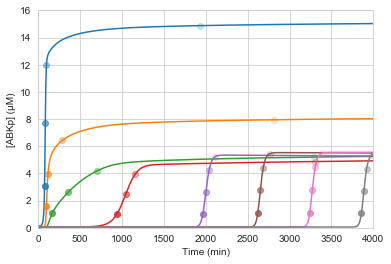

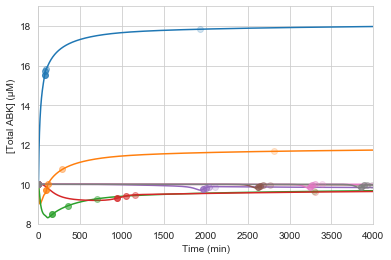

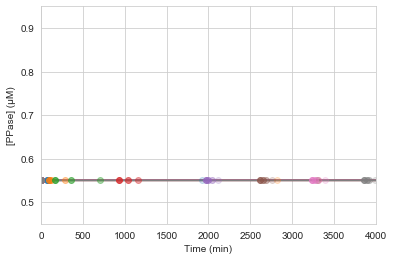

In [18]:
"""
Supplemental Figure 18D/F/H
plots active kinase / total kinase / PPase curves (diffusible + bound) with time of the 8 x_slices
plus points indicating 4 intervals in respect to low/high steady states

- decreasing total kinase not accompanied by associate decrease in PPase in the stall region,
thus prolonging activation
- since PPase is fixed, total kinase diffuses toward the oncoming traveling front along the arms
instead of PPase
"""

t_of_xslices, ABKp_of_xslices, totalABK_of_xslices, PPase_of_xslices = discretize_into_slices(x_slices)

t = np.arange(0, t_end+.1, t_save)
# active kinase trajectories + interval points
for x_slice in x_slices:
    plt.plot(t/60, ABKp_time_profile(x_slice))
for x_slice,ts,ABKps,color in zip(x_slices, t_of_xslices, ABKp_of_xslices, colors):
    for t_,ABKp_,alp in zip(ts, ABKps, alphas):
        plt.plot(t_*t_save, ABKp_, color, alpha=alp)

plt.xlim(0,t_end/60)
plt.ylim(0,16)
plt.ylabel('[ABKp] (\u03BCM)')
plt.xlabel('Time (min)')
plt.show()

# total kinase trajectories + interval points
for x_slice in x_slices:
    plt.plot(t/60, totalABK_time_profile(x_slice))
for x_slice,ts,totalABKs,color in zip(x_slices, t_of_xslices, totalABK_of_xslices, colors):
    for t_,totalABK_,alp in zip(ts, totalABKs, alphas):
        plt.plot(t_*t_save, totalABK_, color, alpha=alp)

plt.xlim(0,t_end/60)
plt.ylim(8,19)
plt.ylabel('[Total ABK] (\u03BCM)')
plt.xlabel('Time (min)')
plt.show()

# PPase trajectories + interval points
for c,x_slice in enumerate(x_slices):
    plt.plot(t/60, PPase_time_profile(x_slice))
for x_slice,ts,PPases,color in zip(x_slices, t_of_xslices, PPase_of_xslices, colors):
    for t_,PPase_,alp in zip(ts, PPases, alphas):
        plt.plot(t_*t_save, PPase_, color, alpha=alp)

plt.xlim(0,t_end/60)
plt.ylim(.45,.95)
plt.ylabel('[PPase] (\u03BCM)')
plt.xlabel('Time (min)');

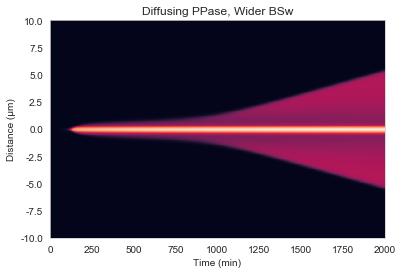

In [19]:
"""
Supplemental Figure 19A
plots simulation results (of Figure 21) as a spatiotemporal heatmap
- no new conclusions, will be used to compare with fixed PPase results below
"""

bindingsim_P055_dynamic = pickle.load(open('bindingsim_P055_dynamic','rb'))

[   A_arr, B_arr, a_arr, b_arr, aA_arr, aB_arr, bA_arr, bB_arr, 
    Ph_arr, PhA_arr, PhB_arr, BS_arr, t_vec 
] = bindingsim_P055_dynamic

plt.pcolor(A_arr+B_arr)
plt.yticks(np.linspace(0,480,9), np.arange(-10, 11, 2.5))
plt.title('Diffusing PPase, Wider BSw')
plt.ylabel('Distance (\u03BCm)')
plt.xlabel('Time (min)');

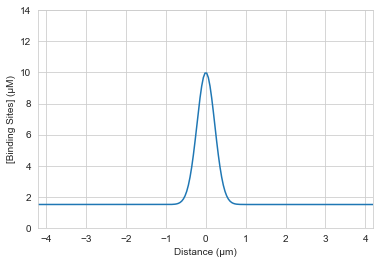

In [20]:
"""
constructs/plots binding site profile to be used for simulations below
"""

N = 480
L = 20
x_span = np.linspace(-L/2,L/2,N)

# narrows initial binding site profile relative to Figure 21A (smaller BSw)
Atot = 10
BSmin = 1.5
BSw = 1

BS0 = (Atot-BSmin) * np.exp(- Atot / BSw * x_span**2) + BSmin

plt.plot(x_span,BS0)
plt.ylim(0,14)
plt.xlim(-4.2,4.2)
plt.ylabel('[Binding Sites] (\u03BCM)')
plt.xlabel('Distance (\u03BCm)');

In [21]:
"""
parameters for simulation below
"""
t_end = 2000*60
dt = 0.035
t_save = 60

A0 = 0
P0 = 0.55

D = 10**-5

In [139]:
"""
simulates reaction/diffusion/localization with 0.55 uM phosphatase + 10e-5 diffusion coefficient
total kinase kept at 10 uM across domain length, initial active kinase at zero
binding site profile used is plotted above
"""

start = time.time()
## algorithm takes ~26 min

bindingsim_P055_dynamic_fixedPPase, y = spatial_simulation_binding_noPPdiff(A0,Atot,P0,t_end,dt,t_save,L,N,BSmin,BSw)

pickle.dump(bindingsim_P055_dynamic_fixedPPase,open('bindingsim_P055_dynamic_fixedPPase','wb'))

end = time.time()
print(f'~ {round( (end - start)/60, 1 )} min')

~ 25.9 min


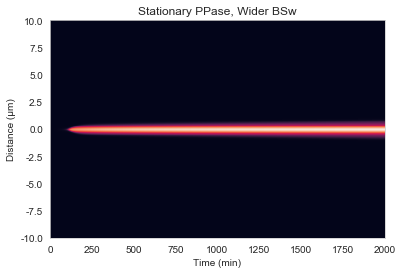

In [22]:
"""
Supplemental Figure 19B
plots simulation results as a spatiotemporal heatmap

- pinned front at the centromere
    - system at the transition region pushes towards the monostable low branch and is not 'saved'
    by an accompanying shift left of the bistability curve via decreasing local PPase
"""

bindingsim_P055_dynamic_fixedPPase = pickle.load(open('bindingsim_P055_dynamic_fixedPPase','rb'))

[   A_arr, B_arr, a_arr, b_arr, aA_arr, aB_arr, bA_arr, bB_arr, 
    Ph_arr, PhA_arr, PhB_arr, BS_arr, t_vec 
] = bindingsim_P055_dynamic_fixedPPase

plt.pcolor(A_arr+B_arr)
plt.yticks(np.linspace(0,480,9), np.arange(-10, 11, 2.5))
plt.title('Stationary PPase, Wider BSw')
plt.ylabel('Distance (\u03BCm)')
plt.xlabel('Time (min)');

# adding binding site ramps along chromosome arms

In [23]:
def spatial_simulation_binding_ramps(A0,Atot,P0,t_end,dt,t_save,L,N,BSmin,BSw,BSrampslope,BSrampstart):
    """
    identical algorithm as spatial_simulation_binding with ramps added to BS0
    """
    A = np.zeros(N) + A0
    B = np.zeros(N)
    a = np.zeros(N) + Atot - A
    b = np.zeros(N)
    aA = np.zeros(N)
    aB = np.zeros(N)
    bA = np.zeros(N)
    bB = np.zeros(N)
    Ph = np.zeros(N) + P0
    PhA = np.zeros(N)
    PhB = np.zeros(N)
    
    x = np.linspace(-L/2, L/2, N)
    
    BS0 = (Atot - BSmin) * np.exp(- Atot / BSw * x**2) + BSmin
    
    # add symmetrical ramps along chromsome ends
    ramp = [BSmin + x*BSrampslope*10/60 for x in list(range(1,len(BS0[round(N/2+BSrampstart/2):])+1))]
    BS0[round(N/2+BSrampstart/2):] = ramp
    BS0[:round(N/2-BSrampstart/2)] = ramp[::-1]
    
    y = A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS0
    
    A_arr = np.zeros((N,round(t_end/t_save)+1))
    B_arr = np.zeros((N,round(t_end/t_save)+1))
    a_arr = np.zeros((N,round(t_end/t_save)+1))
    b_arr = np.zeros((N,round(t_end/t_save)+1))
    aA_arr = np.zeros((N,round(t_end/t_save)+1))
    aB_arr = np.zeros((N,round(t_end/t_save)+1))
    bA_arr = np.zeros((N,round(t_end/t_save)+1))
    bB_arr = np.zeros((N,round(t_end/t_save)+1))
    Ph_arr = np.zeros((N,round(t_end/t_save)+1))
    PhA_arr = np.zeros((N,round(t_end/t_save)+1))
    PhB_arr = np.zeros((N,round(t_end/t_save)+1))
    BS_arr = np.zeros((N,round(t_end/t_save)+1))
    t_vec = np.zeros(round(t_end/t_save)+1)
    
    A_arr[:,0] = A
    a_arr[:,0] = a
    Ph_arr[:,0] = Ph
    BS_arr[:,0] = BS0
    
    dz = mesh_fourier(0,L,N)
    dz2 = np.dot(dz,dz)
    
    counter = -1
    counter_save = 0
    t = 0
    
    for i in range(round(t_end/dt)+1):
        counter += 1
        
        dy = R_binding(y)
        
        A += dt*(dy[0] + D*np.dot(dz2,A))
        B += dt*dy[1]
        a += dt*(dy[2] + D*np.dot(dz2,a))
        b += dt*dy[3]
        aA += dt*(dy[4] + D*np.dot(dz2,aA))
        aB += dt*dy[5]
        bA += dt*dy[6]
        bB += dt*dy[7]
        Ph += dt*(dy[8] + D*np.dot(dz2,Ph))
        PhA += dt*(dy[9] + D*np.dot(dz2,PhA))
        PhB += dt*dy[10]
        
        BS = BS0 - B - b - aB - bA - 2*bB - PhB
        
        y = A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS
        
        t += dt
        
        if counter == round(t_save/dt):
            counter = 0
            counter_save += 1
            
            A_arr[:,counter_save] = A
            B_arr[:,counter_save] = B
            a_arr[:,counter_save] = a
            b_arr[:,counter_save] = b
            aA_arr[:,counter_save] = aA
            aB_arr[:,counter_save] = aB
            bA_arr[:,counter_save] = bA
            bB_arr[:,counter_save] = bB
            Ph_arr[:,counter_save] = Ph
            PhA_arr[:,counter_save] = PhA
            PhB_arr[:,counter_save] = PhB
            BS_arr[:,counter_save] = BS
            t_vec[counter_save] = t
    
    arrays = A_arr, B_arr, a_arr, b_arr, aA_arr, aB_arr, bA_arr, bB_arr, Ph_arr, PhA_arr, PhB_arr, BS_arr, t_vec
    y = A, B, a, b, aA, aB, bA, bB, Ph, PhA, PhB, BS
    
    return arrays, y

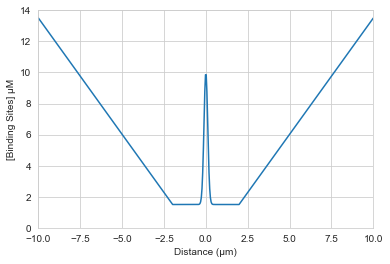

In [24]:
"""
Figure 23A
constructs/plots binding site profile to be used for simulations below
"""
N = 480
L = 20
x = np.linspace(-L/2, L/2, N)

Atot = 10
BSmin = 1.5
BSw = .25
BSrampslope = 1.5/4
BSrampstart = 24*4

BS0 = (Atot-BSmin) * np.exp(- Atot / BSw * x**2) + BSmin

ramp = [BSmin + x*BSrampslope*10/60 for x in list(range(1,len(BS0[round(N/2+BSrampstart/2):])+1))]
BS0[round(N/2+BSrampstart/2):] = ramp
BS0[:round(N/2-BSrampstart/2)] = ramp[::-1]

plt.ylim(0,14)
plt.xlim(-10,10)
plt.ylabel('[Binding Sites] \u03BCM')
plt.xlabel('Distance (\u03BCm)')

plt.plot(x,BS0);

In [25]:
"""
parameters for simulation below
"""
t_end = 2000*60
dt = 0.03
t_save = 60

A0 = 0
P0 = 0.55

D = 10**-5

In [168]:
"""
simulates reaction/diffusion/localization with 0.55 uM phosphatase + 10e-5 diffusion coefficient
total kinase kept at 10 uM across domain length, initial active kinase at zero
binding site profile used is plotted above
"""

start = time.time()
## algorithm takes ~34 min

bindingsim_P055_dynamic_slope1p5, y = spatial_simulation_binding_ramps(A0,Atot,P0,t_end,dt,t_save,L,N,BSmin,BSw,BSrampslope,BSrampstart)

pickle.dump(bindingsim_P055_dynamic_slope1p5,open('bindingsim_P055_dynamic_slope1p5','wb'))

end = time.time()
print(f'~ {round( (end - start)/60, 1 )} min')

~ 34.2 min


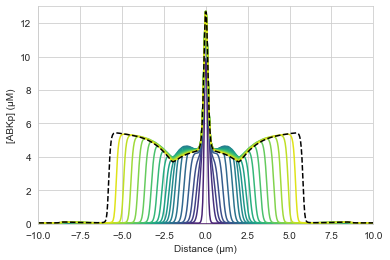

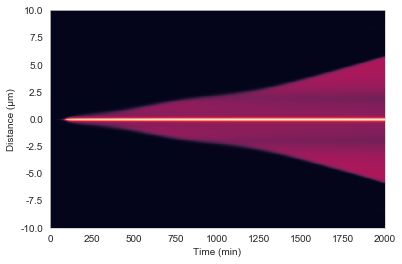

In [26]:
"""
Figure 23C
plots simulation results with a 100 min separation between each spatial profile
Figure 23E
plots simulation results as a spatiotemporal heatmap

- second stall established at the ramp origin, where propagation temporarily slows
"""

bindingsim_P055_dynamic_slope1p5 = pickle.load(open('bindingsim_P055_dynamic_slope1p5','rb'))

[   A_arr, B_arr, a_arr, b_arr, aA_arr, aB_arr, bA_arr, bB_arr, 
    Ph_arr, PhA_arr, PhB_arr, BS_arr, t_vec 
] = bindingsim_P055_dynamic_slope1p5

end = int(t_end/60)
lin_range = range(0,end,100)
colors = sns.color_palette('viridis', n_colors=len(lin_range))

for n,i in enumerate(lin_range):
    plt.plot(x_span, A_arr[:,i]+B_arr[:,i], color=colors[n])
plt.plot(x_span, A_arr[:,-1]+B_arr[:,-1], 'k--')
plt.xlabel("Distance (\u03BCm)")
plt.ylabel("[ABKp] (\u03BCM)")
plt.ylim(0,13)
plt.xlim(-10,10)
plt.show()

plt.pcolor(A_arr+B_arr)
plt.yticks(np.linspace(0,480,9), np.arange(-10, 11, 2.5))
plt.ylabel('Distance (\u03BCm)')
plt.xlabel('Time (min)')
plt.show()

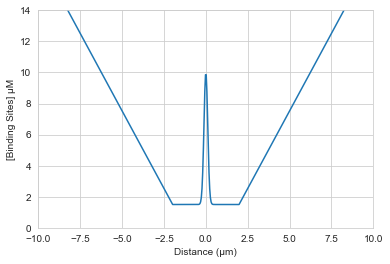

In [27]:
"""
Figure 23B
constructs/plots binding site profile to be used for simulations below

increases ramp slope relative to above
"""
N = 480
L = 20
x = np.linspace(-L/2, L/2, N)

Atot = 10
BSmin = 1.5
BSw = .25
BSrampslope = 2/4 
BSrampstart = 24*4

BS0 = (Atot-BSmin) * np.exp(- Atot / BSw * x**2) + BSmin

ramp = [BSmin + x*BSrampslope*10/60 for x in list(range(1,len(BS0[round(N/2+BSrampstart/2):])+1))]
BS0[round(N/2+BSrampstart/2):] = ramp
BS0[:round(N/2-BSrampstart/2)] = ramp[::-1]

plt.ylim(0,14)
plt.xlim(-10,10)
plt.ylabel('[Binding Sites] \u03BCM')
plt.xlabel('Distance (\u03BCm)')

plt.plot(x,BS0);

In [28]:
"""
set parameters for simulation below
"""
t_end = 6000*60
dt = 0.03
t_save = 60

A0 = 0
P0 = 0.55

D = 10**-5

In [183]:
"""
simulate reaction/diffusion/localization with 0.55 uM phosphatase + 10e-5 diffusion coefficient
total kinase kept at 10 uM across domain length, initial active kinase at zero
binding site profile used is plotted above
"""

start = time.time()
## algorithm takes ~2 hr

bindingsim_P055_dynamic_slope2, y = spatial_simulation_binding_ramps(A0,Atot,P0,t_end,dt,t_save,L,N,BSmin,BSw,BSrampslope,BSrampstart)

pickle.dump(bindingsim_P055_dynamic_slope2,open('bindingsim_P055_dynamic_slope2','wb'))

end = time.time()
print(f'~ {round( (end - start)/60, 1 )} min')

~ 113.7 min


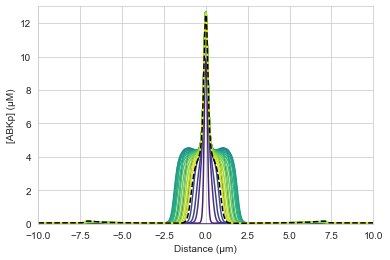

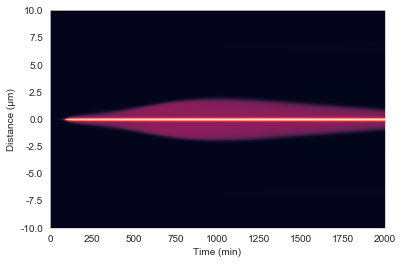

In [29]:
"""
Figure 23D
plots simulation results with a 100 min separation between each spatial profile
Figure 23F
plots simulation results as a spatiotemporal heatmap

- front slows to a stop + reverses direction at the ramp origin
    - more pronounced behavior due to the increase in ramp slope relative to the above plots
"""
bindingsim_P055_dynamic_slope2 = pickle.load(open('bindingsim_P055_dynamic_slope2','rb'))

[   A_arr, B_arr, a_arr, b_arr, aA_arr, aB_arr, bA_arr, bB_arr, 
    Ph_arr, PhA_arr, PhB_arr, BS_arr, t_vec 
] = bindingsim_P055_dynamic_slope2

end = 2000
lin_range = range(0,end,100)
colors = sns.color_palette('viridis', n_colors=len(lin_range))

for n,i in enumerate(lin_range):
    plt.plot(x_span, A_arr[:,i]+B_arr[:,i], color=colors[n])
plt.plot(x_span, A_arr[:,2000]+B_arr[:,2000], 'k--')
plt.xlabel("Distance (\u03BCm)")
plt.ylabel("[ABKp] (\u03BCM)")
plt.ylim(0,13)
plt.xlim(-10,10)
plt.show()

plt.pcolor(A_arr[:,:2000]+B_arr[:,:2000])
plt.yticks(np.linspace(0,480,9), np.arange(-10, 11, 2.5))
plt.ylabel('Distance (\u03BCm)')
plt.xlabel('Time (min)')
plt.show()

In [30]:
"""
restricts the temporally specific, ABKp spatial profile to spatial boundaries
"""

def ABKp_space_profile_interval(x_start,x_end,t):
    return A_arr[x_start:x_end,t]+B_arr[x_start:x_end,t]

In [31]:
"""
combines three simulations to a list for ease of comparing
"""

bindingsim_P055_dynamic_slope0 = pickle.load(open('bindingsim_P055_dynamic_narrow','rb'))
bindingsim_P055_dynamic_slope1p5 = pickle.load(open('bindingsim_P055_dynamic_slope1p5','rb'))
bindingsim_P055_dynamic_slope2 = pickle.load(open('bindingsim_P055_dynamic_slope2','rb'))

array_list = [
    bindingsim_P055_dynamic_slope0,
    bindingsim_P055_dynamic_slope1p5,
    bindingsim_P055_dynamic_slope2
]

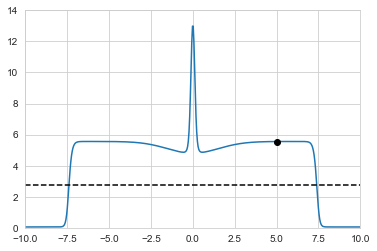

In [32]:
"""
defines max active kinase level on chromosome arms
the half max will be used to spatially define the propagating wave
"""

A_arr,B_arr,a_arr,b_arr,aA_arr,aB_arr,bA_arr,bB_arr,Ph_arr,PhA_arr,PhB_arr,BS_arr,t_vec = array_list[0]

t = 2000
plt.plot(x_span, ABKp_space_profile(t))
plt.ylim(0,14)
plt.xlim(-10,10)

# defines max arm ABKp level
x = 360
hi_ss = ABKp_pt(x,t)

plt.plot(x_span[x], hi_ss, 'ko')
plt.axhline(hi_ss/2, color='k', ls='--');

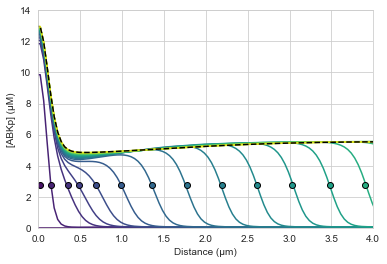

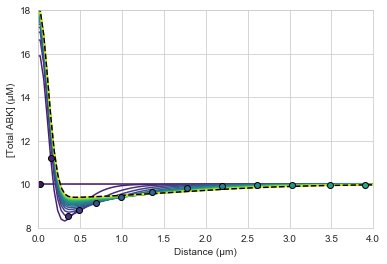

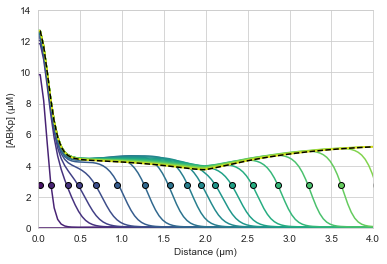

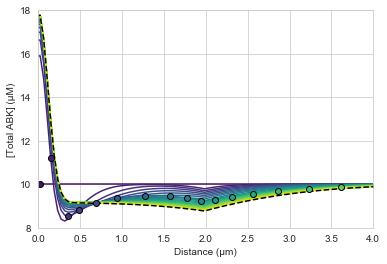

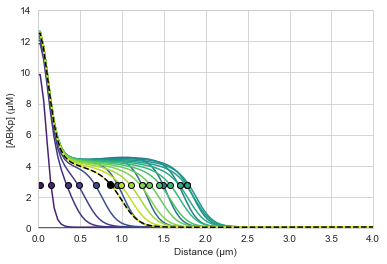

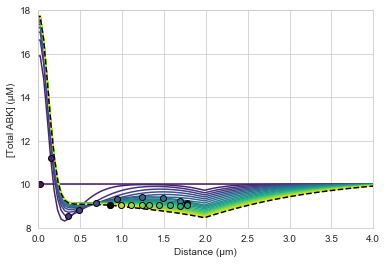

In [33]:
"""
Supplemental Figure 20 A/B/C/D/E/F
plots time evolution of spatial profiles (right half) of active kinase / total kinase
uses the half max point of the front to chart progression + to relate active/total kinase behavior 

- shows the kinase wells that develop at the start of binding site ramps
    - lower ramp causing a 2nd stall
    - high ramp causing a reversal
"""

end = 2000
lin_range = range(0,end,100)
colors = sns.color_palette('viridis', n_colors=len(lin_range))

L = 20
N = 480
x_span = np.linspace(-L/2,L/2,N)
xlim = 4

for array in array_list:
    A_arr,B_arr,a_arr,b_arr,aA_arr,aB_arr,bA_arr,bB_arr,Ph_arr,PhA_arr,PhB_arr,BS_arr,t_vec = array
    
    ## plot ABKp vs distance
    ## half activated arm steady states plotted as points for each time step
    front_x_positions = []
    for n,i in enumerate(lin_range):
        plt.plot(x_span, ABKp_space_profile(i), color=colors[n])
    plt.plot(x_span, ABKp_space_profile(i), 'k--')
    for n,i in enumerate(lin_range):
        right_front = find_nearest(ABKp_space_profile_interval(int(len(x_span)/2),-1,i), hi_ss/2)[1]
        plt.plot(x_span[right_front+int(len(x_span)/2)],
                 hi_ss/2,
                 color=colors[n],marker='o',markeredgecolor='k')
        front_x_positions.append(right_front+int(len(x_span)/2))

    right_front = find_nearest(ABKp_space_profile_interval(int(len(x_span)/2),-1,i), hi_ss/2)[1]
    plt.plot(x_span[right_front+int(len(x_span)/2)],
             ABKp_pt(right_front+int(len(x_span)/2),i),
             color='k',marker='o')
    front_x_positions.append(right_front+int(len(x_span)/2))
    plt.xlabel("Distance (\u03BCm)")
    plt.ylabel("[ABKp] (\u03BCM)")
    plt.ylim(0,14)
    plt.xlim(0,xlim)
    plt.show()
    
    
    ## plot total ABK vs distance
    ## half activated arm steady states plotted as points for each time step
    for n,(t,x) in enumerate(zip(lin_range, front_x_positions[:-1])):
        plt.plot(x_span, totalABK_space_profile(t), color=colors[n])
    plt.plot(x_span, totalABK_space_profile(end), 'k--')
    for n,(t,x) in enumerate(zip(lin_range, front_x_positions[:-1])):
        plt.plot(x_span[x],totalABK_pt(x,t),color=colors[n],marker='o',markeredgecolor='k')
    x = front_x_positions[-1]
    plt.plot(x_span[x],totalABK_pt(x,i),color='k',marker='o')
    
    plt.xlabel("Distance (\u03BCm)")
    plt.ylabel("[Total ABK] (\u03BCM)")
    plt.ylim(8,18)
    plt.xlim(0,xlim)
    plt.show()

In [34]:
def rt_front_data_collection(t_end,t_interval,array):
    """
    calls spatial profile data + calculates front progression
    orders into lists to be used for animations
    """
    
    t_range = range(0,t_end,t_interval)
    
    A_arr,B_arr,a_arr,b_arr,aA_arr,aB_arr,bA_arr,bB_arr,Ph_arr,PhA_arr,PhB_arr,BS_arr,t_vec = array
    
    ABKp_list = []
    right_front_list = []
    x_right_front_list = []
    Atot_list = []
    Atot_pt_list = []

    for t in t_range:
        ABKp_list.append(ABKp_space_profile(t))
        right_front = find_nearest(ABKp_space_profile_interval(int(len(x_span)/2),-1,t), hi_ss/2)[1] + int(len(x_span)/2)
        right_front_list.append(right_front)
        x_right_front_list.append(x_span[right_front])
        Atot_list.append(totalABK_space_profile(t))
        Atot_pt_list.append(totalABK_pt(right_front,t))
        
    return ABKp_list, right_front_list, x_right_front_list, Atot_list, Atot_pt_list

In [20]:
"""
Supplemental Movie 3 (a)
compiles animation for front progression dynamics via local active/total kinase levels
uses the mass-action model, plots profiles every 10 min

tracks half max active kinase level of left plot 
with the related spatial position / total kinase level of the right plot
charts trajectory of total kinase level in blue

- no binding site profile ramp - front moves linearly rightward
"""

# calls necessary data 
t_end = 2000
t_interval = 20
arrays = bindingsim_P055_dynamic_slope0
A_arr,B_arr,a_arr,b_arr,aA_arr,aB_arr,bA_arr,bB_arr,Ph_arr,PhA_arr,PhB_arr,BS_arr,t_vec = arrays
ABKp_list,rt_front_list,x_rt_front_list,Atot_list,Atot_pt_list = rt_front_data_collection(t_end,t_interval,arrays)

fig, (ax1, ax2) = plt.subplots(1, 2)
fig.patch.set_facecolor('white')
fig.set_size_inches(12,4)
fig.set_dpi(80)

ax1.set(xlim=(0,4), ylim=(0,14))
ax1.set_xlabel('Distance (\u03BCm)')
ax1.set_ylabel('[ABKp] (\u03BCM)')

ax2.set(xlim=(0,4), ylim=(8,18))
ax2.set_xlabel('Distance (\u03BCm)')
ax2.set_ylabel('[Total ABK] (\u03BCM)')

ax1line, = ax1.plot([], [], 'k')
ax1dot, = ax1.plot([], [], 'C0o')

ax2line, = ax2.plot([], [], 'k')
ax2dot, = ax2.plot([], [], 'C0o')
ax2traj, = ax2.plot([], [], 'C0')

def animate(t):
    
    ax1line.set_data(x_span, ABKp_list[t])
    rt_front = rt_front_list[t]
    ax1dot.set_data(x_span[rt_front],hi_ss/2)    
    
    ax2line.set_data(x_span, Atot_list[t])
    ax2dot.set_data(x_span[rt_front],Atot_pt_list[t])
    ax2traj.set_data(x_rt_front_list[:t],Atot_pt_list[:t])
    
    return ax1line,

plt.close()
plt.rcParams["animation.html"] = "jshtml"
animation.FuncAnimation(fig, animate, frames=int(t_end/t_interval), interval=20, blit=True)

In [21]:
"""
Supplemental Movie 3 (b)
compiles animation for front progression dynamics via local active/total kinase levels
uses the mass-action model, plots profiles every 10 min

tracks half max active kinase level of left plot 
with the related spatial position / total kinase level of the right plot
charts trajectory of total kinase level in blue

- low binding site profile ramp - front moves right + stalls at 2 um + continues right
"""

t_end = 2000
t_interval = 20
arrays = bindingsim_P055_dynamic_slope1p5
A_arr,B_arr,a_arr,b_arr,aA_arr,aB_arr,bA_arr,bB_arr,Ph_arr,PhA_arr,PhB_arr,BS_arr,t_vec = arrays

ABKp_list,rt_front_list,x_rt_front_list,Atot_list,Atot_pt_list = rt_front_data_collection(t_end,t_interval,arrays)

fig, (ax1, ax2) = plt.subplots(1, 2)
fig.patch.set_facecolor('white')
fig.set_size_inches(12,4)
fig.set_dpi(80)

ax1.set(xlim=(0,4), ylim=(0,14))
ax1.set_xlabel('Distance (\u03BCm)')
ax1.set_ylabel('[ABKp] (\u03BCM)')

ax2.set(xlim=(0,4), ylim=(8,18))
ax2.set_xlabel('Distance (\u03BCm)')
ax2.set_ylabel('[Total ABK] (\u03BCM)')

ax1line, = ax1.plot([], [], 'k')
ax1dot, = ax1.plot([], [], 'C0o')

ax2line, = ax2.plot([], [], 'k')
ax2dot, = ax2.plot([], [], 'C0o')
ax2traj, = ax2.plot([], [], 'C0')

def animate(t):
    
    ax1line.set_data(x_span, ABKp_list[t])
    rt_front = rt_front_list[t]
    ax1dot.set_data(x_span[rt_front],hi_ss/2)
    
    ax2line.set_data(x_span, Atot_list[t])
    ax2dot.set_data(x_span[rt_front],Atot_pt_list[t])
    ax2traj.set_data(x_rt_front_list[:t],Atot_pt_list[:t])
    
    return ax1line,

plt.close()
animation.FuncAnimation(fig, animate, frames=int(t_end/t_interval), interval=20, blit=True)

In [22]:
"""
Supplemental Movie 3 (c)
compiles animation for front progression dynamics via local active/total kinase levels
uses the mass-action model, plots profiles every 10 min

tracks half max active kinase level of left plot 
with the related spatial position / total kinase level of the right plot
charts trajectory of total kinase level in blue

- high binding site profile ramp - front moves right until slowing/stopping at kinase well + reverses
"""

t_end = 2000
t_interval = 20
arrays = bindingsim_P055_dynamic_slope2
A_arr,B_arr,a_arr,b_arr,aA_arr,aB_arr,bA_arr,bB_arr,Ph_arr,PhA_arr,PhB_arr,BS_arr,t_vec = arrays

ABKp_list,rt_front_list,x_rt_front_list,Atot_list,Atot_pt_list = rt_front_data_collection(t_end,t_interval,arrays)

fig, (ax1, ax2) = plt.subplots(1, 2)
fig.patch.set_facecolor('white')
fig.set_size_inches(12,4)
fig.set_dpi(80)

ax1.set(xlim=(0,4), ylim=(0,14))
ax1.set_xlabel('Distance (\u03BCm)')
ax1.set_ylabel('[ABKp] (\u03BCM)')

ax2.set(xlim=(0,4), ylim=(8,18))
ax2.set_xlabel('Distance (\u03BCm)')
ax2.set_ylabel('[Total ABK] (\u03BCM)')

ax1line, = ax1.plot([], [], 'k')
ax1dot, = ax1.plot([], [], 'C0o')

ax2line, = ax2.plot([], [], 'k')
ax2dot, = ax2.plot([], [], 'C0o')
ax2traj, = ax2.plot([], [], 'C0')

def animate(t):
    
    ax1line.set_data(x_span, ABKp_list[t])
    rt_front = rt_front_list[t]
    ax1dot.set_data(x_span[rt_front],hi_ss/2)
    
    ax2line.set_data(x_span, Atot_list[t])
    ax2dot.set_data(x_span[rt_front],Atot_pt_list[t])
    ax2traj.set_data(x_rt_front_list[:t],Atot_pt_list[:t])
    
    return ax1line,

plt.close()
animation.FuncAnimation(fig, animate, frames=int(t_end/t_interval), interval=20, blit=True)

# high binding site ramp : autoactivation in the outer arms

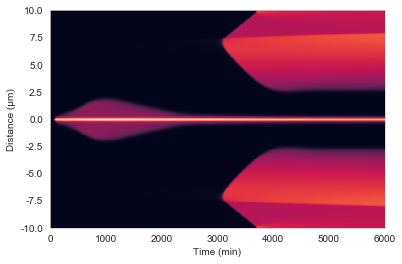

In [42]:
"""
Figure 24
plots extended results of the high BS slope simulation as a spatiotemporal heatmap

- after reversal, kinase autoactivates at two symmetric points in the outer chromosome arms
- traveling front from the outer arm pins at the ramp origin, as occurred for the centromeric front
"""
bindingsim_P055_dynamic_slope2 = pickle.load(open('bindingsim_P055_dynamic_slope2','rb'))

[   A_arr, B_arr, a_arr, b_arr, aA_arr, aB_arr, bA_arr, bB_arr, 
    Ph_arr, PhA_arr, PhB_arr, BS_arr, t_vec 
] = bindingsim_P055_dynamic_slope2

plt.pcolor(A_arr+B_arr)
plt.yticks(np.linspace(0,480,9), np.arange(-10, 11, 2.5))
plt.ylabel('Distance (\u03BCm)')
plt.xlabel('Time (min)')
plt.show()

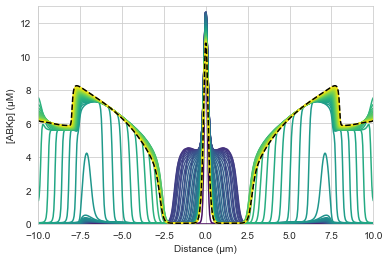

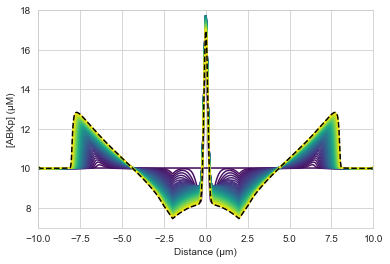

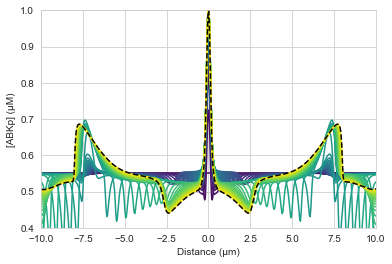

In [48]:
"""
Supplemental Figure 21A/B/C
plots time evolutions of active kinase / total kinase / PPase spatial profiles
with a 100 min separation between each profile

- autoactivation points correspond to total kinase peaks that develop
    - kinase diffuses from the inner to outer arm, filling the binding site profile ramp
    - once system moves out of the bistable region / into the monostable high branch : autoactivation
- outer arm front does not have enough 'momentum' to move past kinase well at ramp origin
"""
bindingsim_P055_dynamic_slope2 = pickle.load(open('bindingsim_P055_dynamic_slope2','rb'))

[   A_arr, B_arr, a_arr, b_arr, aA_arr, aB_arr, bA_arr, bB_arr, 
    Ph_arr, PhA_arr, PhB_arr, BS_arr, t_vec 
] = bindingsim_P055_dynamic_slope2

t_end = 6000
lin_range = range(0,t_end,100)
colors = sns.color_palette('viridis', n_colors=len(lin_range))

for n,i in enumerate(lin_range):
    plt.plot(x_span, ABKp_space_profile(i), color=colors[n])
plt.plot(x_span, ABKp_space_profile(-1), 'k--')
plt.xlabel("Distance (\u03BCm)")
plt.ylabel("[ABKp] (\u03BCM)")
plt.ylim(0,13)
plt.xlim(-10,10)
plt.show()

for n,i in enumerate(lin_range):
    plt.plot(x_span, totalABK_space_profile(i), color=colors[n])
plt.plot(x_span, totalABK_space_profile(-1), 'k--')
plt.xlabel("Distance (\u03BCm)")
plt.ylabel("[ABKp] (\u03BCM)")
plt.ylim(7,18)
plt.xlim(-10,10)
plt.show()

for n,i in enumerate(lin_range):
    plt.plot(x_span, PPase_space_profile(i), color=colors[n])
plt.plot(x_span, PPase_space_profile(-1), 'k--')
plt.xlabel("Distance (\u03BCm)")
plt.ylabel("[ABKp] (\u03BCM)")
plt.ylim(.4,1)
plt.xlim(-10,10)
plt.show()

In [25]:
"""
Supplemental Movie 4 (a)
compiles animation for active kinase dynamics 
in the high binding site ramp slope system
uses the mass-action model, plots profiles every 10 min
"""
t_end = 6000
t_interval = 40

fig, ax = plt.subplots()
fig.patch.set_facecolor('white')
fig.set_size_inches(6,4)
fig.set_dpi(80)

ax.set(xlim=(-10,10), ylim=(0,14))
ax.set_xlabel('Distance (\u03BCm)')
ax.set_ylabel('[ABKp] (\u03BCM)')

line, = ax.plot([], [], 'k')

def animate(i):
    line.set_data(x_span, ABKp_space_profile(i*t_interval))
    return line,

plt.close()
animation.FuncAnimation(fig, animate, frames=int(t_end/t_interval), interval=20, blit=True)

In [26]:
"""
Supplemental Movie 4 (b)
compiles animation for total kinase dynamics 
in the high binding site ramp slope system
uses the mass-action model, plots profiles every 10 min
"""
t_end = 6000
t_interval = 40

fig, ax = plt.subplots()
fig.patch.set_facecolor('white')
fig.set_size_inches(6,4)
fig.set_dpi(80)

ax.set(xlim=(-10,10), ylim=(7,18))
ax.set_xlabel('Distance (\u03BCm)')
ax.set_ylabel('[Total ABK] (\u03BCM)')

line, = ax.plot([], [], 'k')

def animate(i):
    line.set_data(x_span, totalABK_space_profile(i*t_interval))
    return line,

plt.close()
animation.FuncAnimation(fig, animate, frames=int(t_end/t_interval), interval=20, blit=True)

In [27]:
"""
Supplemental Movie 4 (c)
compiles animation for PPase dynamics 
in the high binding site ramp slope system
uses the mass-action model, plots profiles every 10 min
"""
t_end = 6000
t_interval = 40

fig, ax = plt.subplots()
fig.patch.set_facecolor('white')
fig.set_size_inches(6,4)
fig.set_dpi(80)

ax.set(xlim=(-10,10), ylim=(.4,1))
ax.set_xlabel('Distance (\u03BCm)')
ax.set_ylabel('[PPase] (\u03BCM)')

line, = ax.plot([], [], 'k')

def animate(i):
    line.set_data(x_span, PPase_space_profile(i*t_interval))
    return line,

plt.close()
animation.FuncAnimation(fig, animate, frames=int(t_end/t_interval), interval=20, blit=True)